In [1]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [3]:
import os
from PIL import Image

def process_and_print_image_info(folder_path):
    image_files = [f for f in os.listdir(folder_path) if f.lower().endswith(('.png', '.jpg', '.jpeg'))]

    print(f"Número total de imágenes en la carpeta: {len(image_files)}")

    for file in image_files:
        image_path = os.path.join(folder_path, file)
        with Image.open(image_path) as img:
            width, height = img.size
            print(f"Imagen: {file}, Ancho: {width}, Alto: {height}")

# Rutas a las carpetas en Google Drive
folder1 = '/content/drive/MyDrive/FotosGranada/gt'  # Reemplaza con la ruta real a la primera carpeta
folder2 = '/content/drive/MyDrive/FotosGranada/src'  # Reemplaza con la ruta real a la segunda carpeta


In [ ]:
def rename_and_convert_images(src_folder, gt_folder):
    src_files = os.listdir(src_folder)
    gt_files = os.listdir(gt_folder)

    for i, src_file in enumerate(src_files, start=1):
        src_file_path = os.path.join(src_folder, src_file)
        gt_file = src_file.split('.')[0] + '.png'
        gt_file_path = os.path.join(gt_folder, gt_file)

        if gt_file in gt_files:
            # Convertir archivos en src a .jpg y renombrar
            new_src_name = f"granada{i}.jpg"
            new_src_path = os.path.join(src_folder, new_src_name)
            with Image.open(src_file_path) as img:
                img.convert('RGB').save(new_src_path, 'JPEG')
            if not src_file.lower().endswith('.jpg'):
                os.remove(src_file_path)

            # Renombrar archivos en gt
            new_gt_name = f"granada{i}.png"
            new_gt_path = os.path.join(gt_folder, new_gt_name)
            os.rename(gt_file_path, new_gt_path)

            print(f"Archivo {src_file} convertido y renombrado a {new_src_name}, y {gt_file} renombrado a {new_gt_name}")

rename_and_convert_images(folder2, folder1)

Archivo chunk_13952.png convertido y renombrado a granada1.jpg, y chunk_13952.png renombrado a granada1.png
Archivo chunk_14277.png convertido y renombrado a granada2.jpg, y chunk_14277.png renombrado a granada2.png
Archivo chunk_14434.png convertido y renombrado a granada3.jpg, y chunk_14434.png renombrado a granada3.png
Archivo chunk_14435.png convertido y renombrado a granada4.jpg, y chunk_14435.png renombrado a granada4.png
Archivo chunk_14439.png convertido y renombrado a granada5.jpg, y chunk_14439.png renombrado a granada5.png
Archivo chunk_14444.png convertido y renombrado a granada6.jpg, y chunk_14444.png renombrado a granada6.png
Archivo chunk_14602.png convertido y renombrado a granada7.jpg, y chunk_14602.png renombrado a granada7.png
Archivo chunk_14601.png convertido y renombrado a granada8.jpg, y chunk_14601.png renombrado a granada8.png
Archivo chunk_14770.png convertido y renombrado a granada9.jpg, y chunk_14770.png renombrado a granada9.png
Archivo chunk_14771.png conv

In [4]:
folder1 = '/content/drive/MyDrive/FotosGranada/train/gt'  # Reemplaza con la ruta real a la primera carpeta
folder2 = '/content/drive/MyDrive/FotosGranada/train/src'  # Reemplaza con la ruta real a la segunda carpeta

print("Procesando imágenes en la primera carpeta:")
process_and_print_image_info(folder1)

print("\nProcesando imágenes en la segunda carpeta:")
process_and_print_image_info(folder2)

folder3 = '/content/drive/MyDrive/FotosGranada/val/gt'  # Reemplaza con la ruta real a la primera carpeta
folder4 = '/content/drive/MyDrive/FotosGranada/val/src'  # Reemplaza con la ruta real a la segunda carpeta

print("Procesando imágenes en la primera carpeta:")
process_and_print_image_info(folder3)

print("\nProcesando imágenes en la segunda carpeta:")
process_and_print_image_info(folder4)

Procesando imágenes en la primera carpeta:
Número total de imágenes en la carpeta: 80
Imagen: granada2.png, Ancho: 400, Alto: 400
Imagen: granada4.png, Ancho: 400, Alto: 400
Imagen: granada5.png, Ancho: 400, Alto: 400
Imagen: granada6.png, Ancho: 400, Alto: 400
Imagen: granada7.png, Ancho: 400, Alto: 400
Imagen: granada8.png, Ancho: 400, Alto: 400
Imagen: granada9.png, Ancho: 400, Alto: 400
Imagen: granada10.png, Ancho: 400, Alto: 400
Imagen: granada11.png, Ancho: 400, Alto: 400
Imagen: granada12.png, Ancho: 400, Alto: 400
Imagen: granada13.png, Ancho: 400, Alto: 400
Imagen: granada14.png, Ancho: 400, Alto: 400
Imagen: granada15.png, Ancho: 400, Alto: 400
Imagen: granada16.png, Ancho: 400, Alto: 400
Imagen: granada17.png, Ancho: 400, Alto: 400
Imagen: granada18.png, Ancho: 400, Alto: 400
Imagen: granada19.png, Ancho: 400, Alto: 400
Imagen: granada20.png, Ancho: 400, Alto: 400
Imagen: granada21.png, Ancho: 400, Alto: 400
Imagen: granada22.png, Ancho: 400, Alto: 400
Imagen: granada24.png

In [ ]:
def extract_number(filename):
    """ Extrae el número de un nombre de archivo en el formato 'granada{N}.ext' """
    basename = os.path.splitext(filename)[0]  # Remueve la extensión
    number = int(basename.replace('granada', ''))  # Remueve el prefijo y convierte a entero
    return number

def overlay_masks(src_folder, gt_folder, transparency=0.5):
    src_files = sorted(os.listdir(src_folder), key=extract_number)
    gt_files = sorted(os.listdir(gt_folder), key=extract_number)

    for src_file, gt_file in zip(src_files, gt_files):
        src_file_path = os.path.join(src_folder, src_file)
        gt_file_path = os.path.join(gt_folder, gt_file)

        with Image.open(src_file_path) as src_img, Image.open(gt_file_path) as gt_img:
            # Asegurarse de que la máscara tenga canal alfa para la transparencia
            gt_img = gt_img.convert("RGBA")

            # Crear una imagen transparente para la máscara
            transparent_gt = Image.new("RGBA", gt_img.size)
            for x in range(gt_img.width):
                for y in range(gt_img.height):
                    r, g, b, a = gt_img.getpixel((x, y))
                    transparent_gt.putpixel((x, y), (r, g, b, int(a * transparency)))

            # Combinar imagen original y máscara transparente
            combined = Image.alpha_composite(src_img.convert("RGBA"), transparent_gt)

            # Convertir a formato RGB para mostrar
            combined = combined.convert("RGB")

            # Mostrar el nombre de las correspondencias
            print(f"Imagen: {src_file}  | Máscara: {gt_file}\n")

            # Mostrar la imagen resultante usando IPython
            display(combined)

            print("\n")



Imagen: granada1.jpg  | Máscara: granada1.png



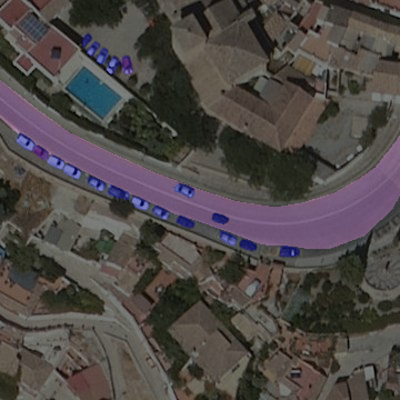



Imagen: granada2.jpg  | Máscara: granada2.png



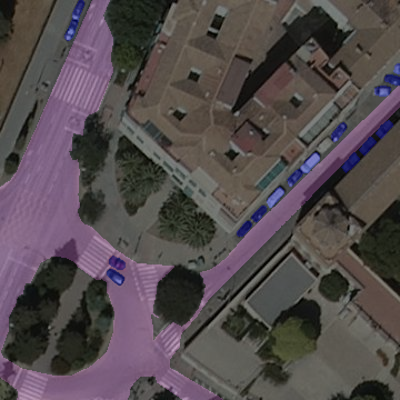



Imagen: granada3.jpg  | Máscara: granada3.png



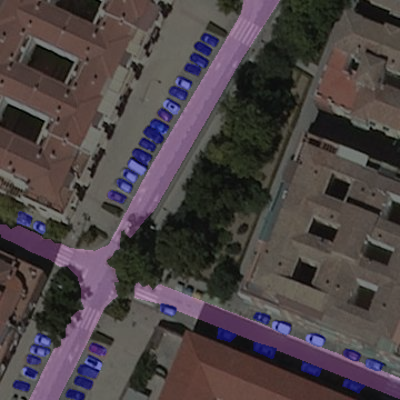



Imagen: granada4.jpg  | Máscara: granada4.png



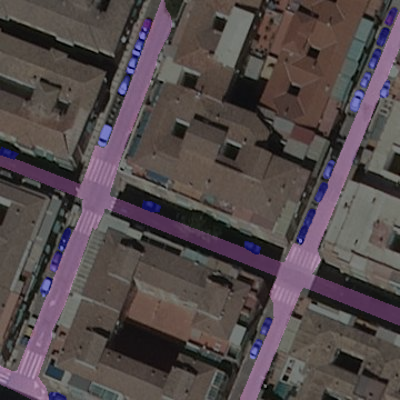



Imagen: granada5.jpg  | Máscara: granada5.png



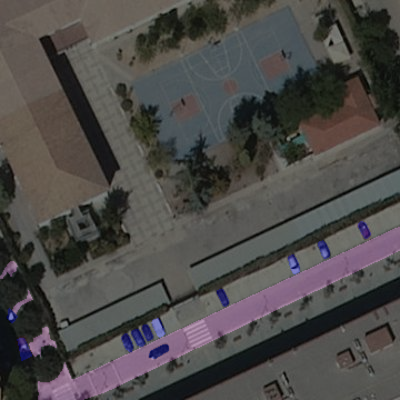



Imagen: granada6.jpg  | Máscara: granada6.png



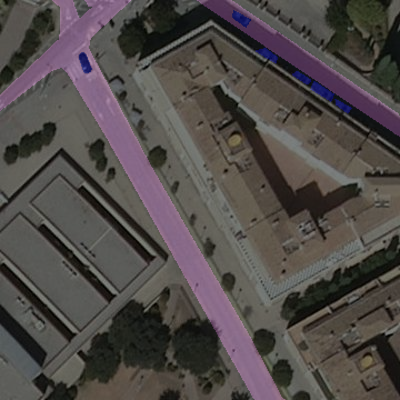



Imagen: granada7.jpg  | Máscara: granada7.png



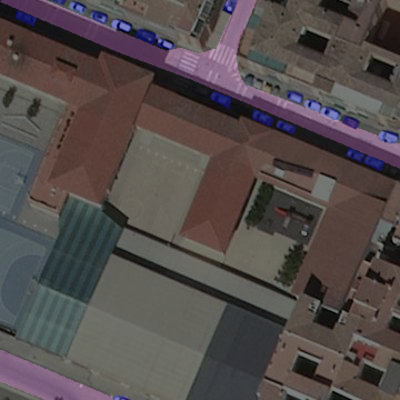



Imagen: granada8.jpg  | Máscara: granada8.png



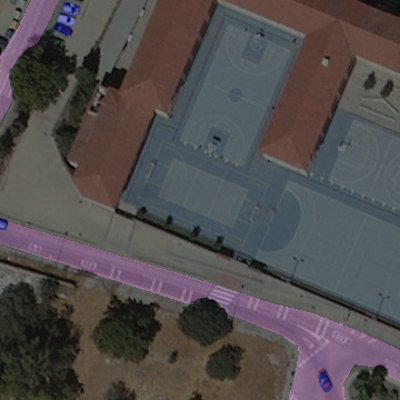



Imagen: granada9.jpg  | Máscara: granada9.png



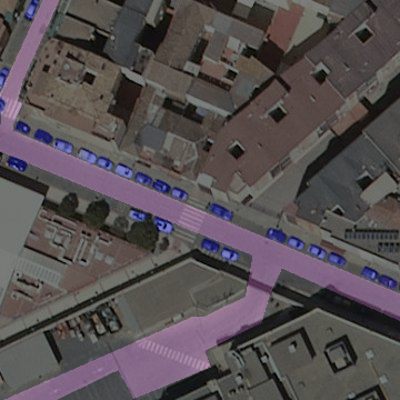



Imagen: granada10.jpg  | Máscara: granada10.png



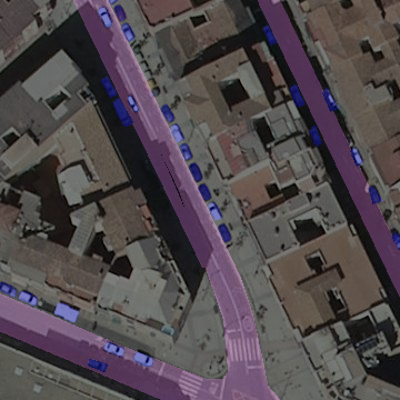



Imagen: granada11.jpg  | Máscara: granada11.png



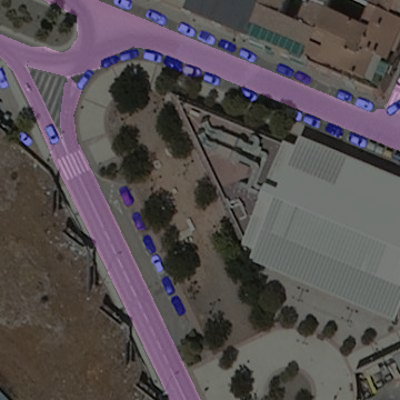



Imagen: granada12.jpg  | Máscara: granada12.png



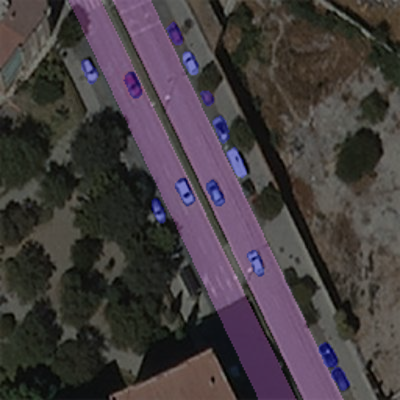



Imagen: granada13.jpg  | Máscara: granada13.png



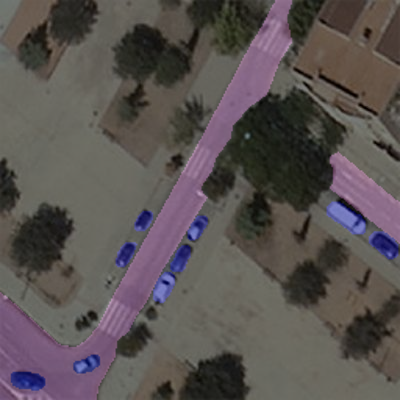



Imagen: granada14.jpg  | Máscara: granada14.png



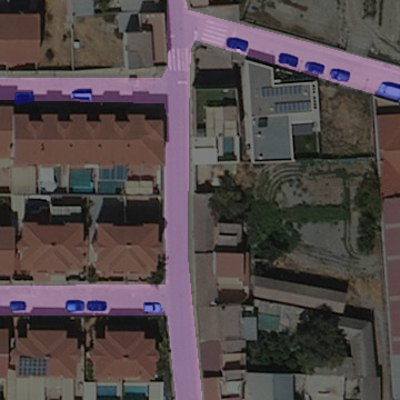



Imagen: granada15.jpg  | Máscara: granada15.png



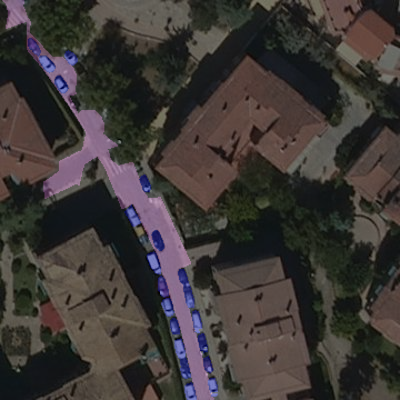



Imagen: granada16.jpg  | Máscara: granada16.png



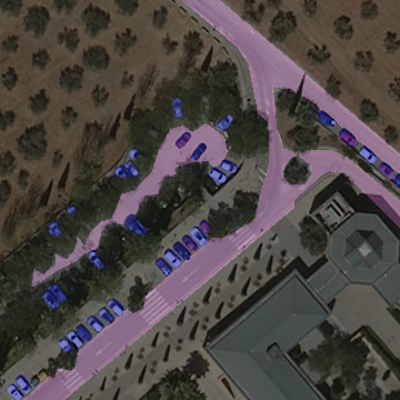



Imagen: granada17.jpg  | Máscara: granada17.png



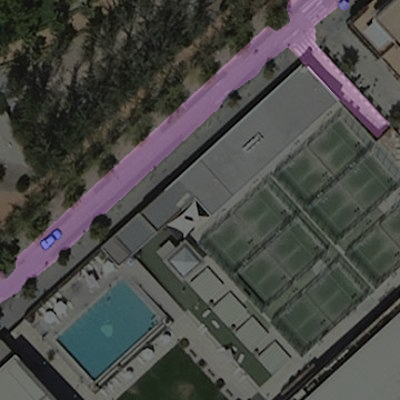



Imagen: granada18.jpg  | Máscara: granada18.png



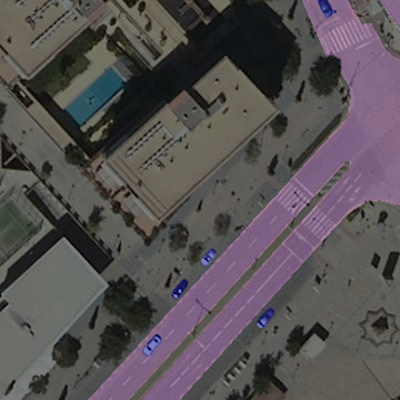



Imagen: granada19.jpg  | Máscara: granada19.png



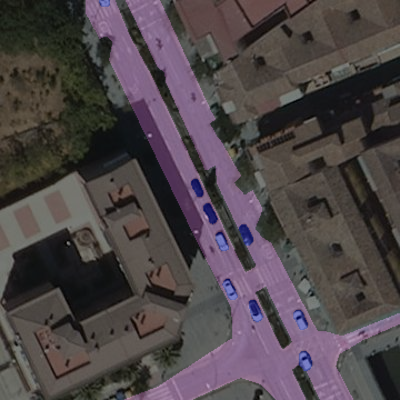



Imagen: granada20.jpg  | Máscara: granada20.png



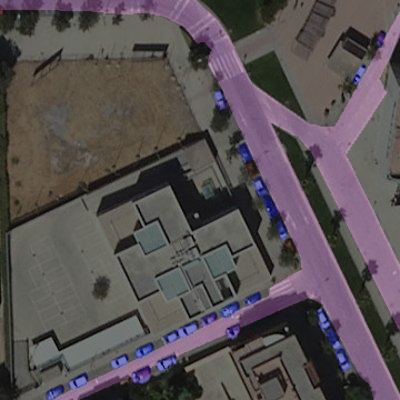



Imagen: granada21.jpg  | Máscara: granada21.png



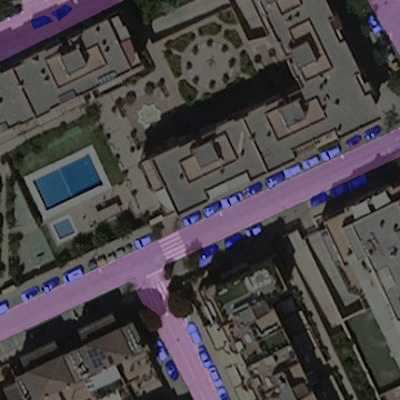



Imagen: granada22.jpg  | Máscara: granada22.png



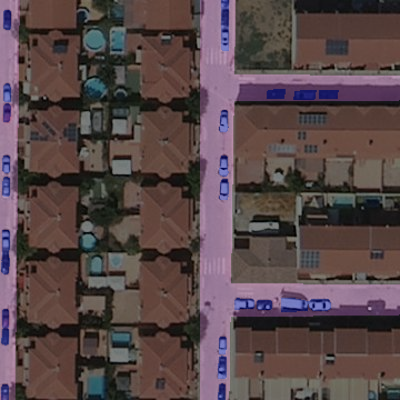



Imagen: granada23.jpg  | Máscara: granada23.png



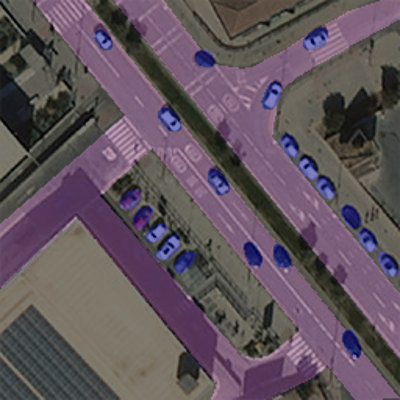



Imagen: granada24.jpg  | Máscara: granada24.png



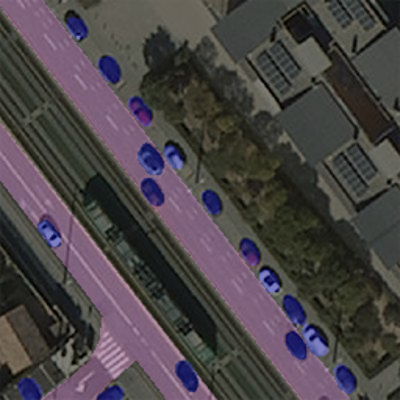



Imagen: granada25.jpg  | Máscara: granada25.png



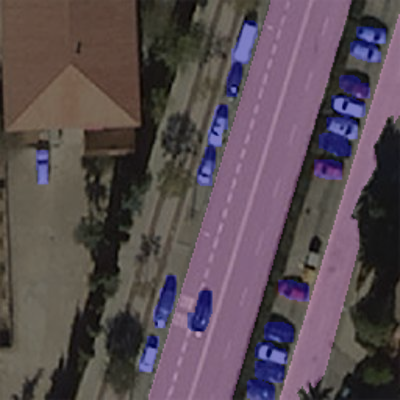



Imagen: granada26.jpg  | Máscara: granada26.png



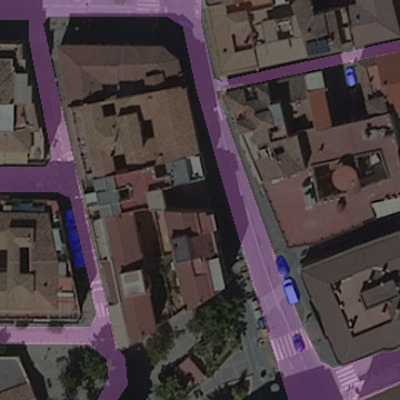



Imagen: granada27.jpg  | Máscara: granada27.png



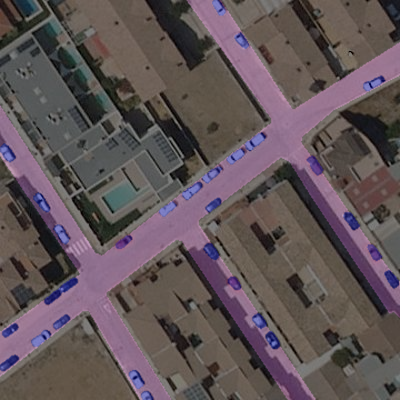



Imagen: granada28.jpg  | Máscara: granada28.png



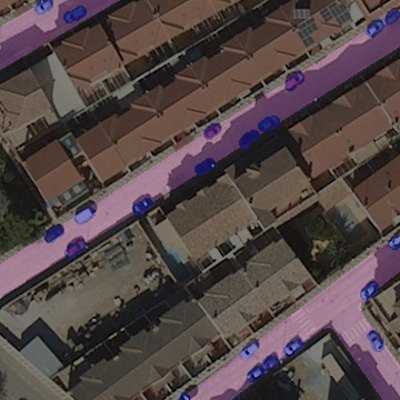



Imagen: granada29.jpg  | Máscara: granada29.png



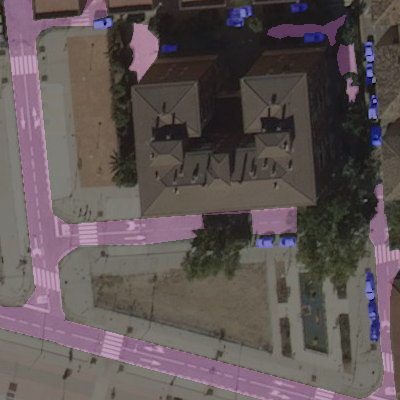



Imagen: granada30.jpg  | Máscara: granada30.png



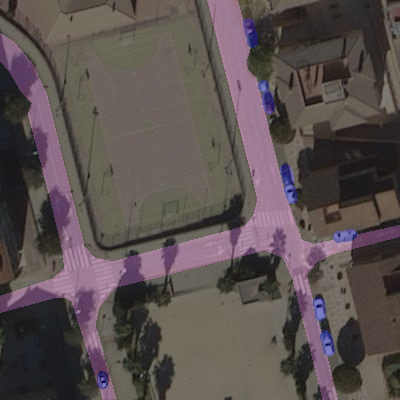



Imagen: granada31.jpg  | Máscara: granada31.png



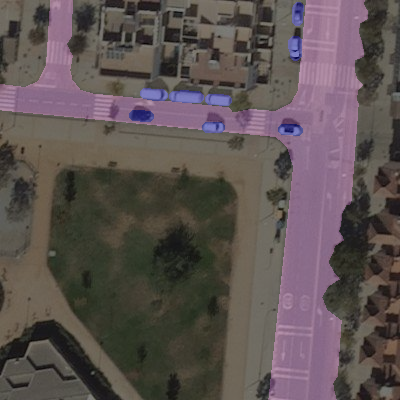



Imagen: granada32.jpg  | Máscara: granada32.png



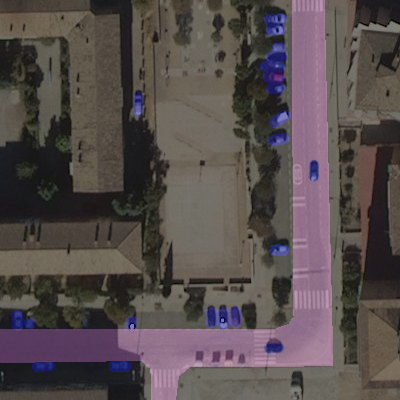



Imagen: granada33.jpg  | Máscara: granada33.png



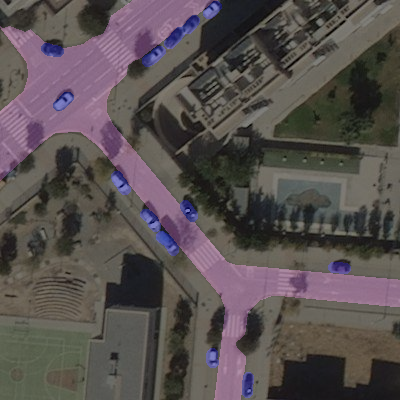



Imagen: granada34.jpg  | Máscara: granada34.png



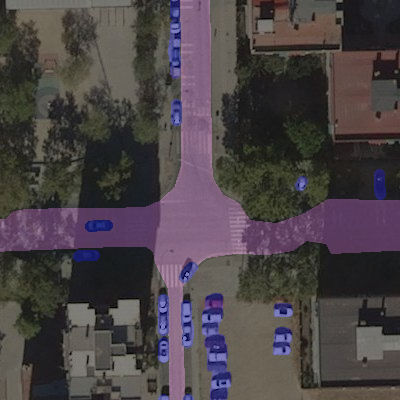



Imagen: granada35.jpg  | Máscara: granada35.png



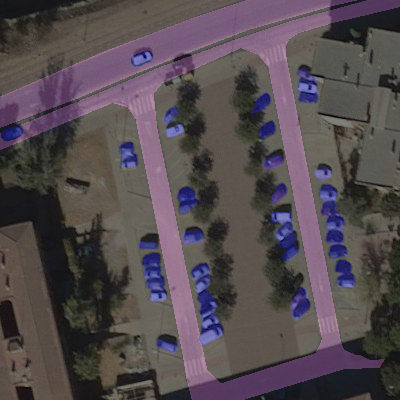



Imagen: granada36.jpg  | Máscara: granada36.png



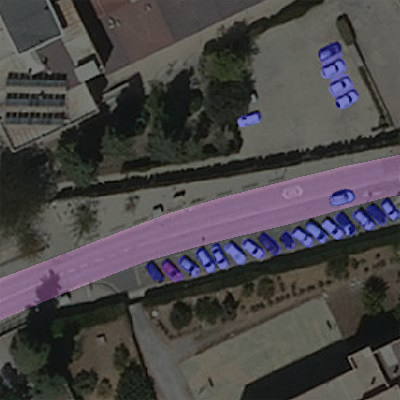



Imagen: granada37.jpg  | Máscara: granada37.png



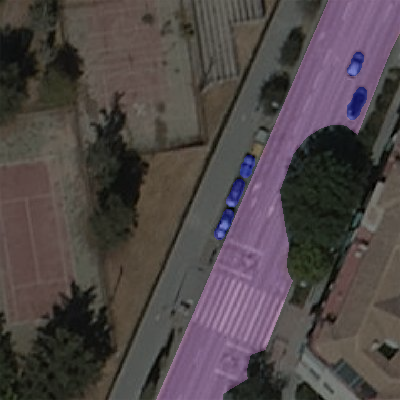



Imagen: granada38.jpg  | Máscara: granada38.png



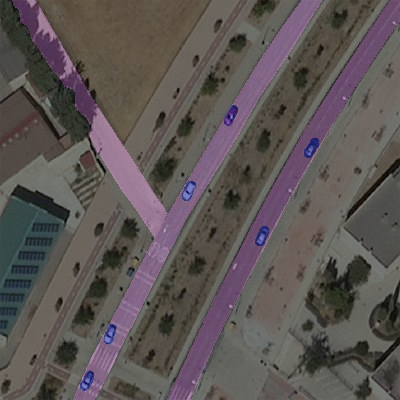



Imagen: granada39.jpg  | Máscara: granada39.png



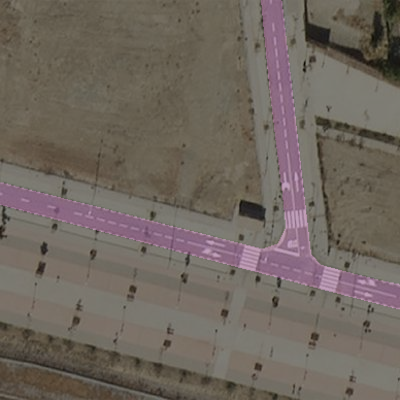



Imagen: granada40.jpg  | Máscara: granada40.png



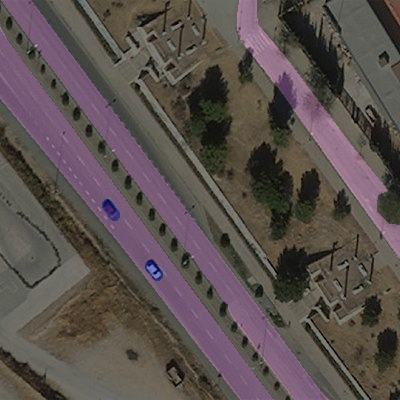



Imagen: granada41.jpg  | Máscara: granada41.png



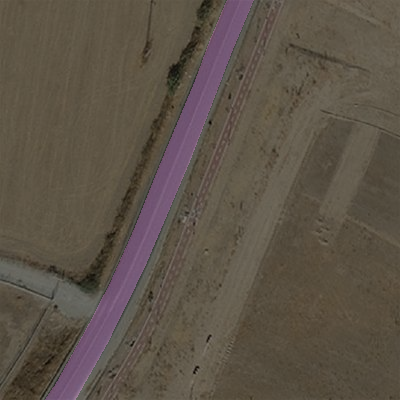



Imagen: granada42.jpg  | Máscara: granada42.png



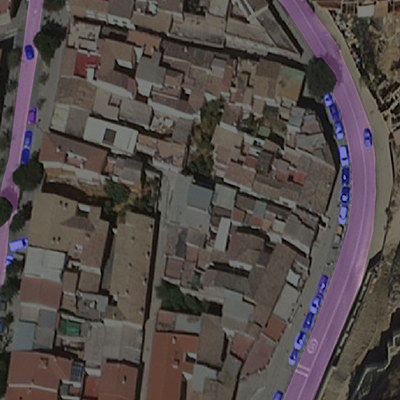



Imagen: granada43.jpg  | Máscara: granada43.png



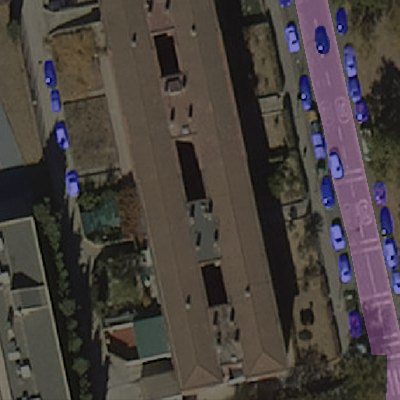



Imagen: granada44.jpg  | Máscara: granada44.png



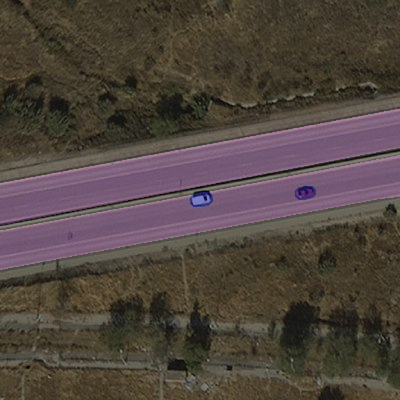



Imagen: granada45.jpg  | Máscara: granada45.png



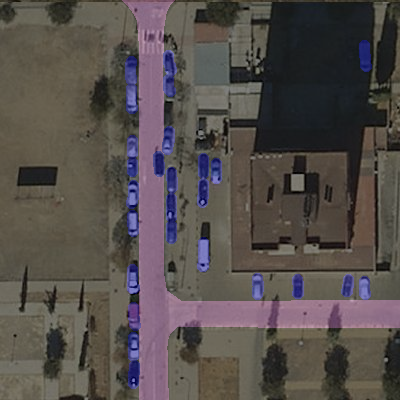



Imagen: granada46.jpg  | Máscara: granada46.png



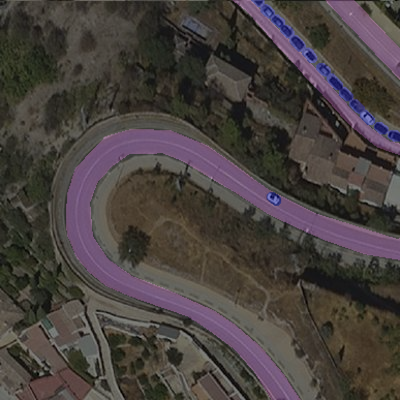



Imagen: granada47.jpg  | Máscara: granada47.png



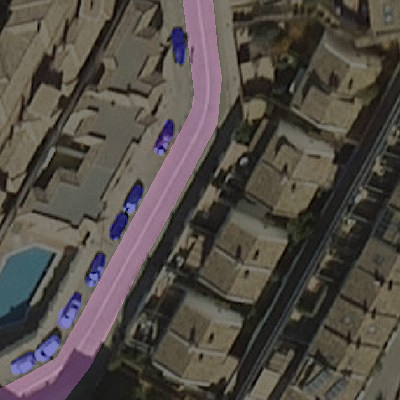



Imagen: granada48.jpg  | Máscara: granada48.png



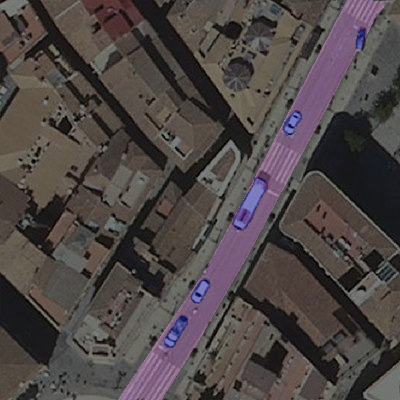



Imagen: granada49.jpg  | Máscara: granada49.png



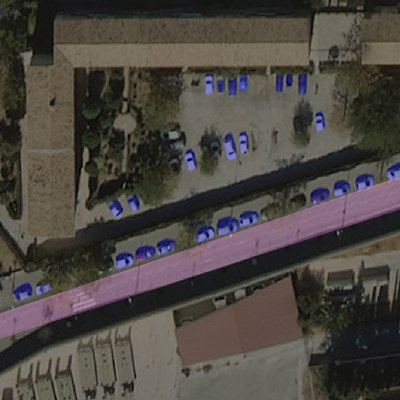



Imagen: granada50.jpg  | Máscara: granada50.png



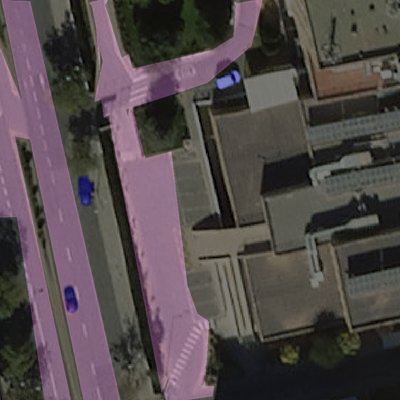



Imagen: granada51.jpg  | Máscara: granada51.png



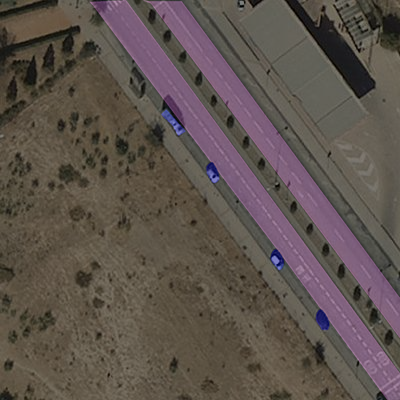



Imagen: granada52.jpg  | Máscara: granada52.png



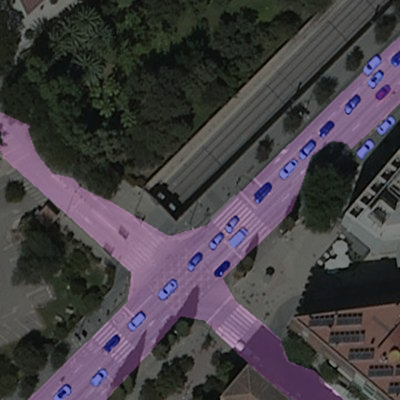



Imagen: granada53.jpg  | Máscara: granada53.png



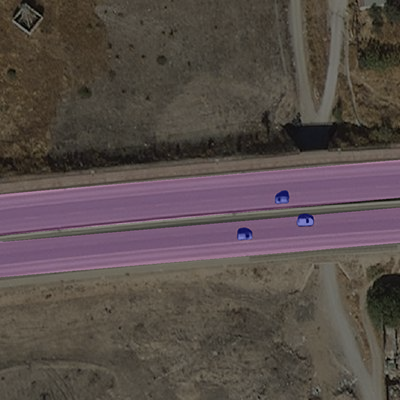



Imagen: granada54.jpg  | Máscara: granada54.png



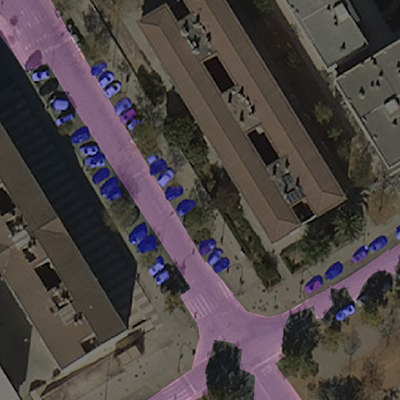



Imagen: granada55.jpg  | Máscara: granada55.png



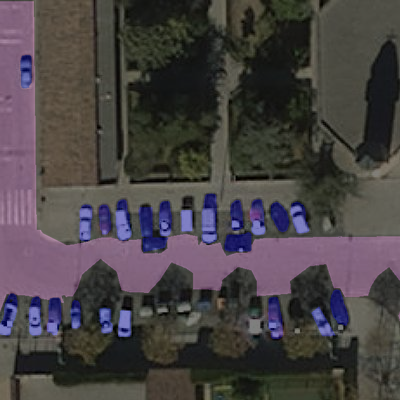



Imagen: granada56.jpg  | Máscara: granada56.png



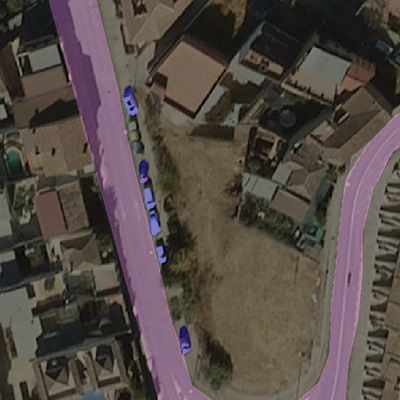



Imagen: granada57.jpg  | Máscara: granada57.png



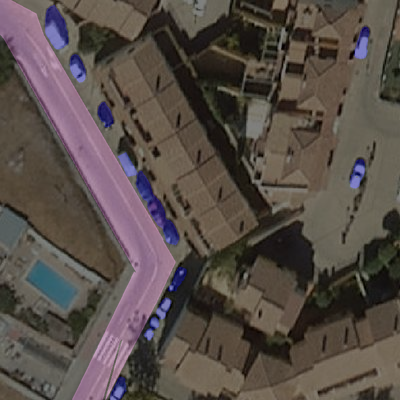



Imagen: granada58.jpg  | Máscara: granada58.png



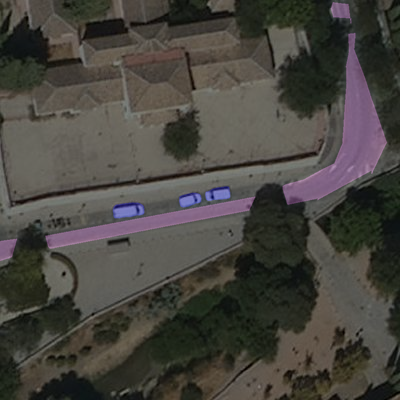



Imagen: granada59.jpg  | Máscara: granada59.png



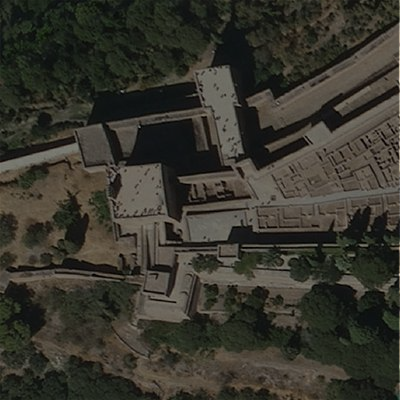



Imagen: granada60.jpg  | Máscara: granada60.png



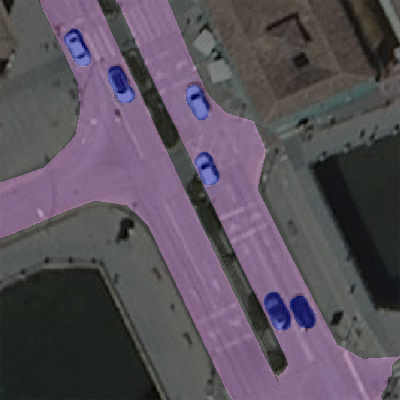



Imagen: granada61.jpg  | Máscara: granada61.png



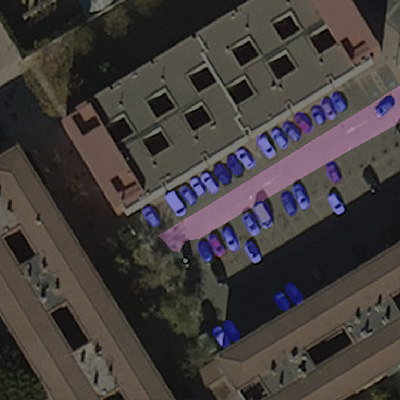



Imagen: granada62.jpg  | Máscara: granada62.png



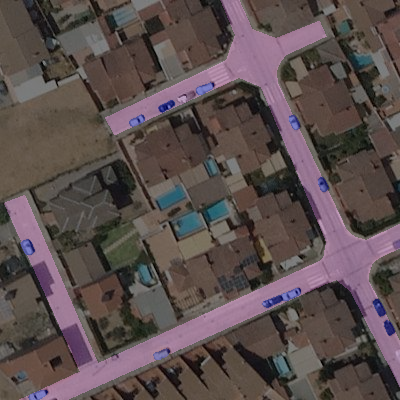



Imagen: granada63.jpg  | Máscara: granada63.png



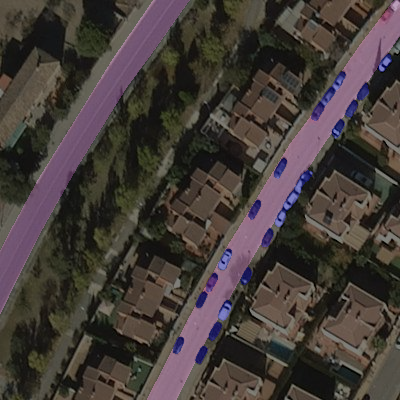



Imagen: granada64.jpg  | Máscara: granada64.png



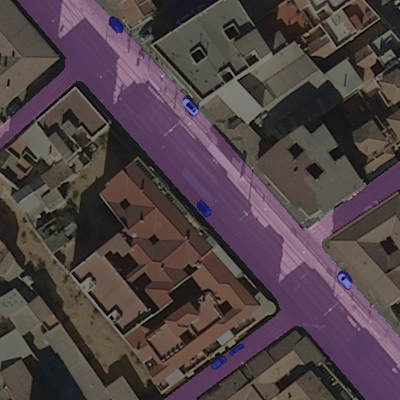



Imagen: granada65.jpg  | Máscara: granada65.png



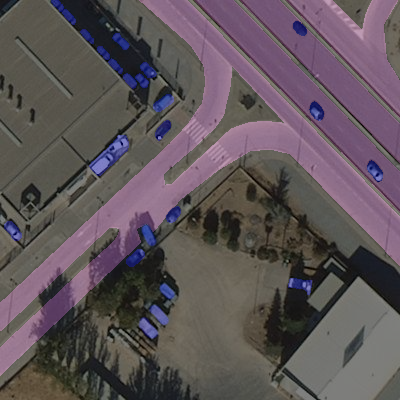



Imagen: granada66.jpg  | Máscara: granada66.png



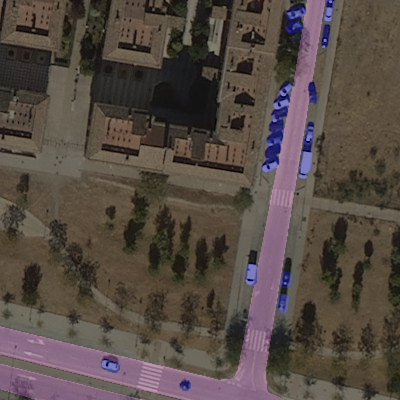



Imagen: granada67.jpg  | Máscara: granada67.png



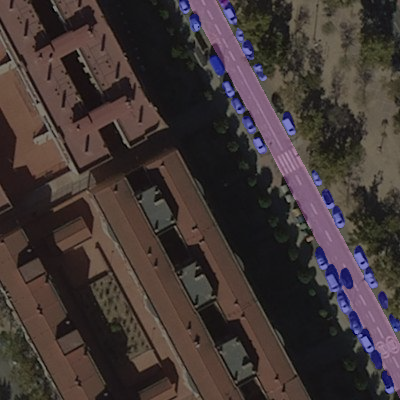



Imagen: granada68.jpg  | Máscara: granada68.png



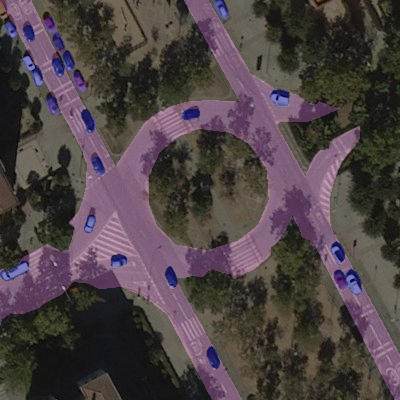



Imagen: granada69.jpg  | Máscara: granada69.png



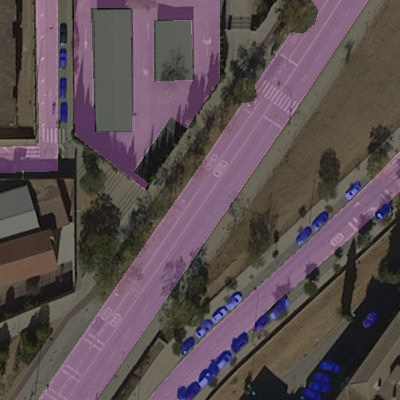



Imagen: granada70.jpg  | Máscara: granada70.png



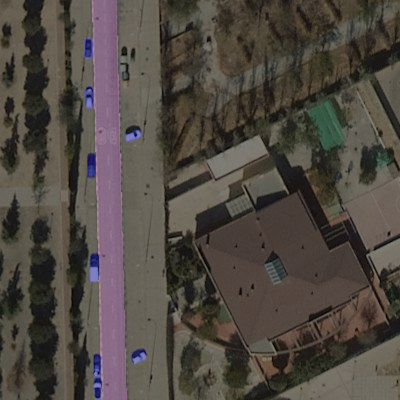



Imagen: granada71.jpg  | Máscara: granada71.png



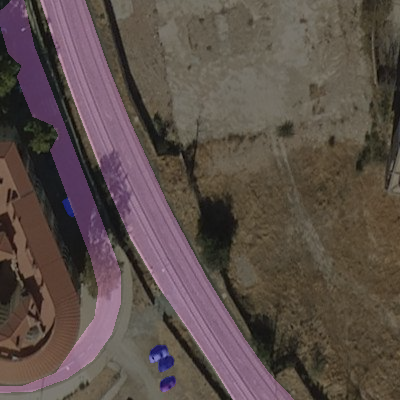



Imagen: granada72.jpg  | Máscara: granada72.png



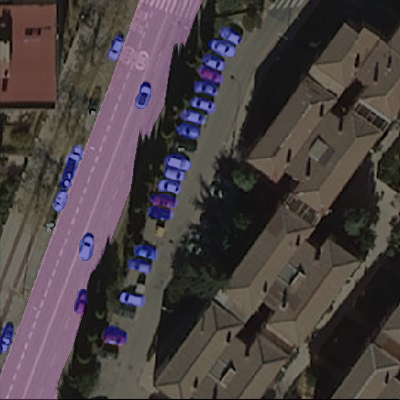



Imagen: granada73.jpg  | Máscara: granada73.png



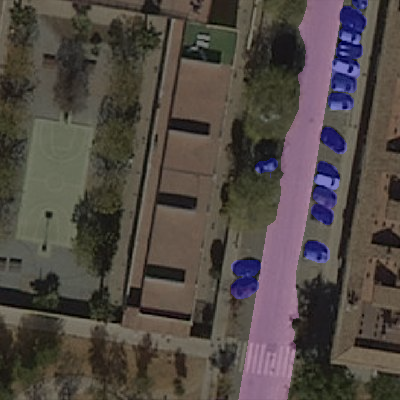



Imagen: granada74.jpg  | Máscara: granada74.png



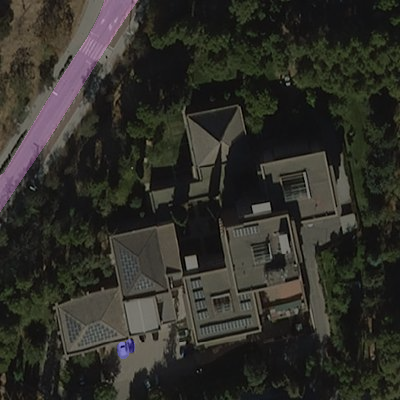



Imagen: granada75.jpg  | Máscara: granada75.png



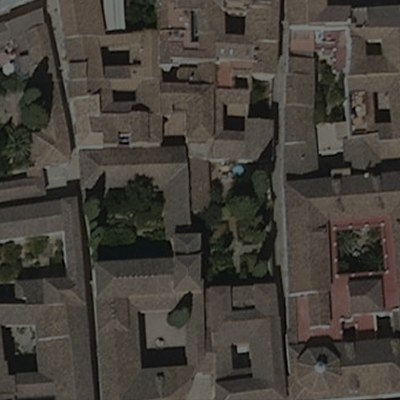



Imagen: granada76.jpg  | Máscara: granada76.png



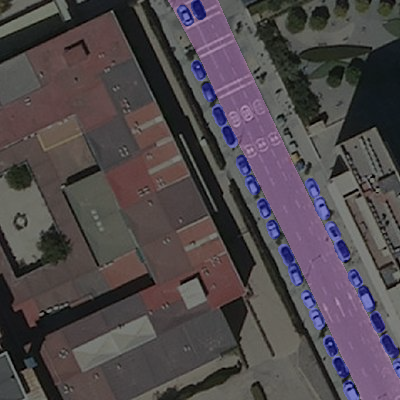



Imagen: granada77.jpg  | Máscara: granada77.png



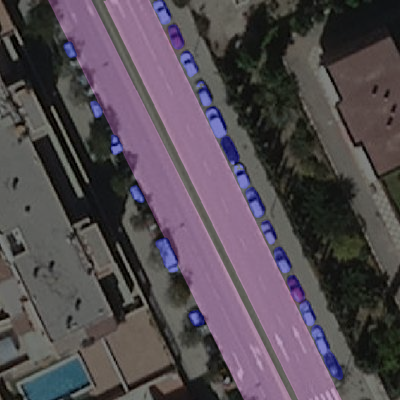



Imagen: granada78.jpg  | Máscara: granada78.png



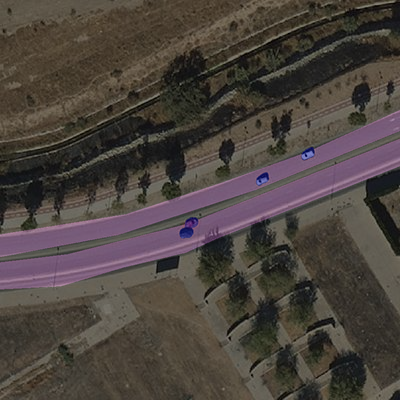



Imagen: granada79.jpg  | Máscara: granada79.png



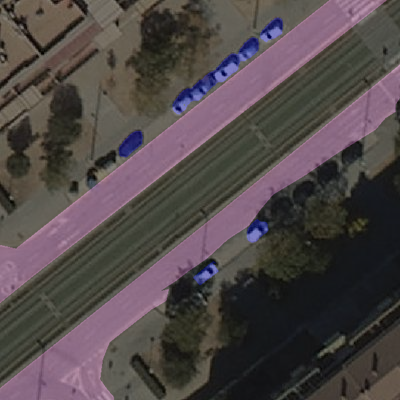



Imagen: granada80.jpg  | Máscara: granada80.png



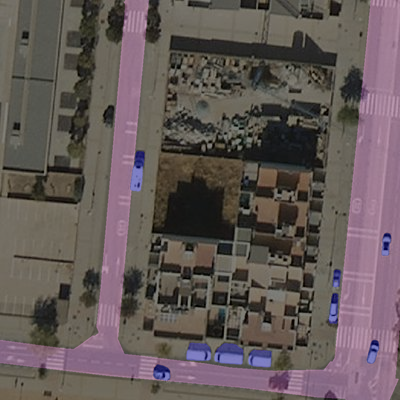



Imagen: granada81.jpg  | Máscara: granada81.png



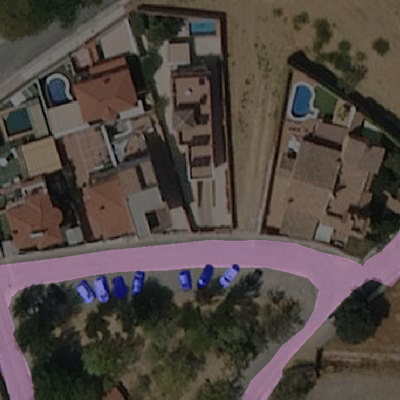



Imagen: granada82.jpg  | Máscara: granada82.png



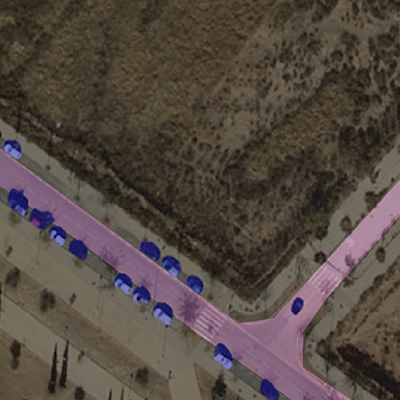



Imagen: granada83.jpg  | Máscara: granada83.png



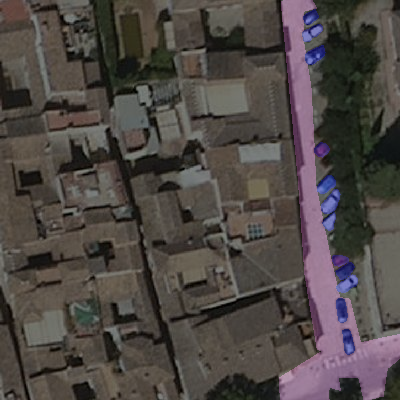



Imagen: granada84.jpg  | Máscara: granada84.png



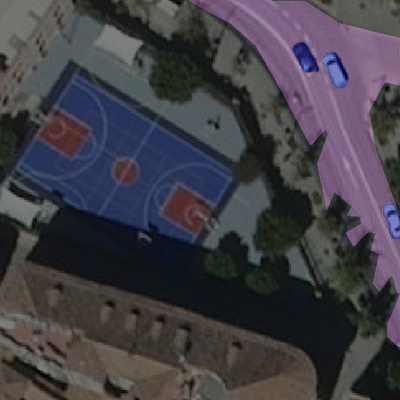



Imagen: granada85.jpg  | Máscara: granada85.png



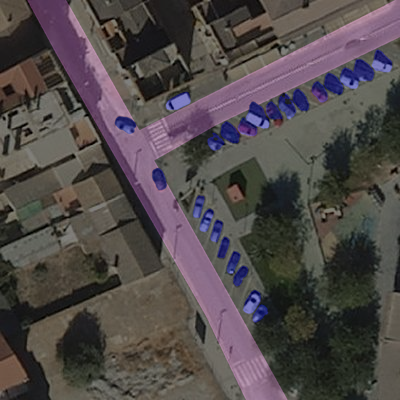



Imagen: granada86.jpg  | Máscara: granada86.png



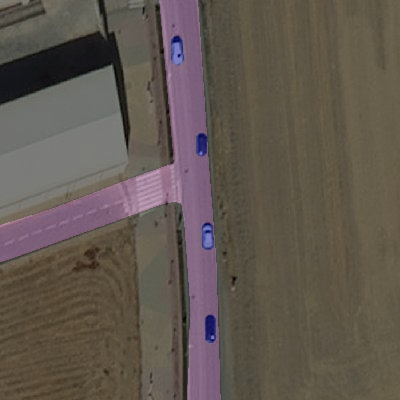



Imagen: granada87.jpg  | Máscara: granada87.png



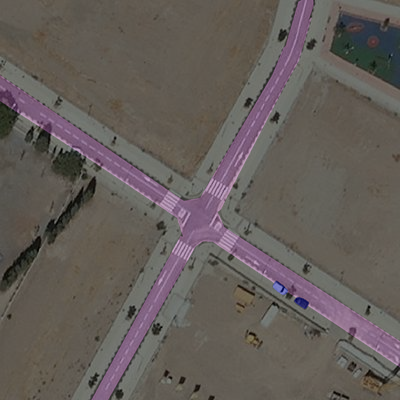



Imagen: granada88.jpg  | Máscara: granada88.png



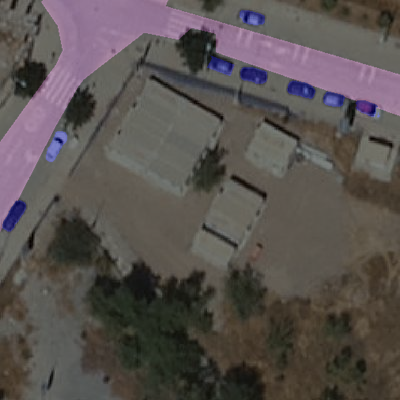



Imagen: granada89.jpg  | Máscara: granada89.png



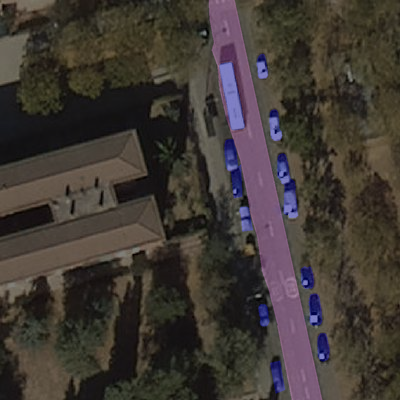



Imagen: granada90.jpg  | Máscara: granada90.png



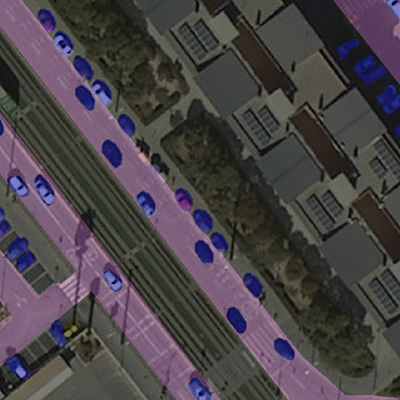

In [ ]:
overlay_masks(folder2, folder1)